In [1]:
import sys
import numpy as np
from scipy import constants,linalg
from numba import jit, njit, prange, set_num_threads
import time
from matplotlib import pyplot as plt

set_num_threads(8)
np.set_printoptions(threshold=sys.maxsize)

Construct the potential matrix with the state of h,k,l,
h = -H,-H+1,...,-1,0,1,...,H-1,H
k = -K,-K+1,...,-1,0,1,...,K-1,K
l = -L,-L+1,...,-1,0,1,...,L-1,L
First constuct a symmetry matrix by pseudmatrix()
pseudomatrix will generate a P matrix with size ((2H+1)*(2K+1)*(2L+1))*((2H+1)*(2K+1)*(2L+1)) in a folloing form
[[[-H,-K,-L],[-H,-K,-L],...,[-H,-K,-L]],
[[-H,-K,-L+1],[-H,-K,-L+1],...,[-H,-K,-L+1]],
...
[[H-1,K,L],[H-1,K,L],...,[H-1,K,L]],
[[H,K,L],[H,K,L],...,[H,K,L]]]
P = P.transpose()-P 
Which P become the states of h,k,l matrix
the potential is the form $\frac{Coeff}{|G_i-G_j|}$ wiich equal to $\frac{Coeff}{|h^2+k^2+l^2}{\frac{2\pi}{a}}^2$
then we can generate potential matrix from P by useing result_matrix()


In [41]:
def potential_matrix(H,K,L,coefficient,reciprocal_basis):
    n=(2*H+1)*(2*K+1)*(2*L+1)
    pseudomatrix=pseudomatrix_kernal(H,K,L,n)
    pseudomatrix=pseudomatrix.transpose((1,0,2))-pseudomatrix
    result_matrix = result_matrix_kernal(pseudomatrix,H,K,L,n,reciprocal_basis)
    return result_matrix*coefficient


def potential_coefficient(a,charges,parameter):
    return -parameter*charges*constants.elementary_charge**2/(a**2*constants.pi*constants.epsilon_0)

In [42]:
@njit(parallel=True)
def pseudomatrix_kernal(H,K,L,n):
    pseudomatrix = np.zeros((n,n,3))
    for h in prange(-H,H+1):
        for k in prange(-K,K+1):
            for l in prange(-L,L+1):
                for j in prange(n):
                    pseudomatrix[(h+H)*((2*K+1)*(2*L+1))+(k+K)*(2*L+1)+(l+L),j]=np.array([h,k,l])
    return pseudomatrix

In [49]:
test_size = 7
pseudomatrix_test = pseudomatrix_kernal(test_size,test_size,test_size,(2*test_size+1)**3)
#print((pseudomatrix_test.transpose((1,0,2)))[:3,:3])
#print((pseudomatrix_test)[:3,:3])
print((pseudomatrix_test.transpose((1,0,2))-pseudomatrix_test)[:6,:6]**2)

[[[ 0.  0.  0.]
  [ 0.  0.  1.]
  [ 0.  0.  4.]
  [ 0.  0.  9.]
  [ 0.  0. 16.]
  [ 0.  0. 25.]]

 [[ 0.  0.  1.]
  [ 0.  0.  0.]
  [ 0.  0.  1.]
  [ 0.  0.  4.]
  [ 0.  0.  9.]
  [ 0.  0. 16.]]

 [[ 0.  0.  4.]
  [ 0.  0.  1.]
  [ 0.  0.  0.]
  [ 0.  0.  1.]
  [ 0.  0.  4.]
  [ 0.  0.  9.]]

 [[ 0.  0.  9.]
  [ 0.  0.  4.]
  [ 0.  0.  1.]
  [ 0.  0.  0.]
  [ 0.  0.  1.]
  [ 0.  0.  4.]]

 [[ 0.  0. 16.]
  [ 0.  0.  9.]
  [ 0.  0.  4.]
  [ 0.  0.  1.]
  [ 0.  0.  0.]
  [ 0.  0.  1.]]

 [[ 0.  0. 25.]
  [ 0.  0. 16.]
  [ 0.  0.  9.]
  [ 0.  0.  4.]
  [ 0.  0.  1.]
  [ 0.  0.  0.]]]


In [47]:
a = potential_matrix(H,K,L,1,SIMPLE_CUBIC)
print(a)

[[0.                inf        inf        inf        inf        inf
         inf        inf        inf        inf        inf 1.
  1.         1.         1.         1.         1.         1.
  1.         1.         1.         1.         0.25       0.25
  0.25       0.25       0.25       0.25       0.25       0.25
  0.25       0.25       0.25       0.11111111 0.11111111 0.11111111
  0.11111111 0.11111111 0.11111111 0.11111111 0.11111111 0.11111111
  0.11111111 0.11111111 0.0625     0.0625     0.0625     0.0625
  0.0625     0.0625     0.0625     0.0625     0.0625     0.0625
  0.0625     0.04       0.04       0.04       0.04       0.04
  0.04       0.04       0.04       0.04       0.04       0.04
  0.02777778 0.02777778 0.02777778 0.02777778 0.02777778 0.02777778
  0.02777778 0.02777778 0.02777778 0.02777778 0.02777778 0.02040816
  0.02040816 0.02040816 0.02040816 0.02040816 0.02040816 0.02040816
  0.02040816 0.02040816 0.02040816 0.02040816 0.015625   0.015625
  0.015625   0.015625   0.0156

In [58]:
@njit(parallel=True)
def result_matrix_kernal(pseudomatrix,H,K,L,n,reciprocal_basis):
    result_matrix = np.zeros((n,n))
    for h in prange(-H,H+1):
        for k in prange(-K,K+1):
            for l in prange(-L,L+1):
                index = (h+H)*((2*K+1)*(2*L+1))+(k+K)*(2*L+1)+(l+L)
                for j in prange(n):
                    if j!=index:
                        result_matrix[index,j]=1/np.sum((pseudomatrix[index][j]*reciprocal_basis)**2)
    return result_matrix

In [68]:
potential_matrix_test = result_matrix_kernal(pseudomatrix_test.transpose((1,0,2))-pseudomatrix_test,test_size,test_size,test_size,(2*test_size+1)**3,SIMPLE_CUBIC)
print(potential_matrix_test[:5,:5])

[[0.         1.         0.25       0.11111111 0.0625    ]
 [1.         0.         1.         0.25       0.11111111]
 [0.25       1.         0.         1.         0.25      ]
 [0.11111111 0.25       1.         0.         1.        ]
 [0.0625     0.11111111 0.25       1.         0.        ]]


In [60]:
#%timeit potential_matrix(1,1,1,1)


H = $E_k$ + U
here we need to construct $E_k$ = $\frac{\hbar^2}{2m}({|k-G|}^2-{|k|}^2)$

In [61]:
def halmitonian(potential_matrix,k_vertor,H,K,L,reciprocal_basis):
    n=(2*H+1)*(2*K+1)*(2*L+1)
    halmitonian_matrix = halmitonian_kernal(k_vertor,H,K,L,reciprocal_basis,n)
    return halmitonian_matrix+potential_matrix


In [62]:
@njit(parallel=True)
def halmitonian_kernal(k_vector,H,K,L,reciprocal_basis,n):
    halmitonian_matrix = np.zeros((n,n))
    for h in prange(-H,H+1):
        for k in prange(-K,K+1):
            for l in prange(-L,L+1):
                index = (h+H)*((2*K+1)*(2*L+1))+(k+K)*(2*L+1)+(l+L)
                halmitonian_matrix[index,index]=np.sum((k_vector-(h*reciprocal_basis[0]+k*reciprocal_basis[1]+l*reciprocal_basis[2]))**2)
    return halmitonian_matrix

In [63]:
def states(N):
    num = np.floor(np.power(N,1.0/3))
    H = num//2
    K = num//2
    L = np.floor(N/((2*H+1)*(2*K+1))//2)
    return int(H),int(K),int(L)


def path_initialize(k_start,k_end,N=50):
    N = int(N)
    k_1 = np.linspace(k_start[0],k_end[0],endpoint=True,num=N)
    k_2 = np.linspace(k_start[1],k_end[1],endpoint=True,num=N)
    k_3 = np.linspace(k_start[2],k_end[2],endpoint=True,num=N)
    return np.array([k_1,k_2,k_3])


In [64]:
def band_structure(H,K,L,radius,charges,parameter,reciprocal_basis,Path):
    start = time.time()
    potentialmatrix=potential_matrix(H,K,L,potential_coefficient(radius,charges,parameter),reciprocal_basis)
    end = time.time()
    E_0 = constants.hbar**2*(2*constants.pi)**2/(2*radius**2*constants.electron_mass)
    potentialmatrix/=E_0
    print(f"Potential matrix calculation done in {end-start:.2f} seconds")
    bands = []
    for path in Path:
        for i in np.arange(len(path[0])):
            start = time.time()
            Ham = halmitonian(potentialmatrix,np.array([path[0][i],path[1][i],path[2][i]]),H,K,L,reciprocal_basis)
            end = time.time()
            print(f"Hamiltonian calculation done in {end-start:.2f} seconds")
            start = time.time()
            eigen_value= linalg.eigvalsh(Ham)
            end = time.time()
            print(f"Eigenvalue calculation done in {end-start:.2f} seconds")
            bands.append(np.sort(eigen_value.real)*E_0)
            print(i)
            print(f"Processed k-point {i+1}/{len(path[0])}")
    return np.stack(bands, axis=-1)

In [65]:
RECIPROCAL_BASIS = np.array([
        [-1, 1, 1],
        [1, -1, 1],
        [1, 1, -1]
])

# sample points per k-path
n = 100

# symmetry points in the Brillouin zone
G = np.array([0, 0, 0])
L = np.array([1/2, 1/2, 1/2])
K = np.array([3/4, 3/4, 0])
X = np.array([0, 0, 1])
W = np.array([1, 1/2, 0])
U = np.array([1/4, 1/4, 1])

# k-paths
lambd = path_initialize(L, G, n)
delta = path_initialize(G, X, n)
x_uk = path_initialize(X, U, n / 4)
sigma = path_initialize(K, G, n)

H,K,L=5,5,5

In [67]:
SIMPLE_CUBIC = np.array([[1,0,0],[0,1,0],[0,0,1]])

GG = np.array([0,0,0])
XX = np.array([0,0.5,0])
MM = np.array([0.5,0.5,0])
RR = np.array([0.5,0.5,0,5])

GX = path_initialize(GG,XX,100)
XM = path_initialize(XX,MM,100)
MR = path_initialize(MM,RR,100)
RG = path_initialize(RR,GG,100)

In [69]:
bands_simple = band_structure(H,K,L,1e-10,1,0,SIMPLE_CUBIC,[GX,XM,MR,RG])


Potential matrix calculation done in 0.12 seconds
Hamiltonian calculation done in 1.16 seconds
Eigenvalue calculation done in 0.25 seconds
0
Processed k-point 1/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.21 seconds
1
Processed k-point 2/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.20 seconds
2
Processed k-point 3/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
3
Processed k-point 4/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
4
Processed k-point 5/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
5
Processed k-point 6/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
6
Processed k-point 7/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
7
Processed k-point 8/100
Hamiltonian calculation done i

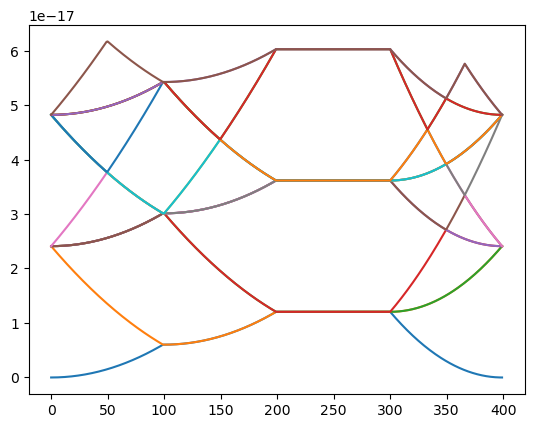

In [71]:
for i in bands_simple[:16]:
    plt.plot(i)

In [20]:


bands1 = band_structure(H,K,L,0.0365*1e-10,14,1,RECIPROCAL_BASIS,[lambd,delta,x_uk,sigma])


Potential matrix calculation done in 0.17 seconds
Hamiltonian calculation done in 0.02 seconds
Eigenvalue calculation done in 0.21 seconds
0
Processed k-point 1/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
1
Processed k-point 2/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.16 seconds
2
Processed k-point 3/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.16 seconds
3
Processed k-point 4/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.16 seconds
4
Processed k-point 5/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.23 seconds
5
Processed k-point 6/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
6
Processed k-point 7/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.16 seconds
7
Processed k-point 8/100
Hamiltonian calculation done i

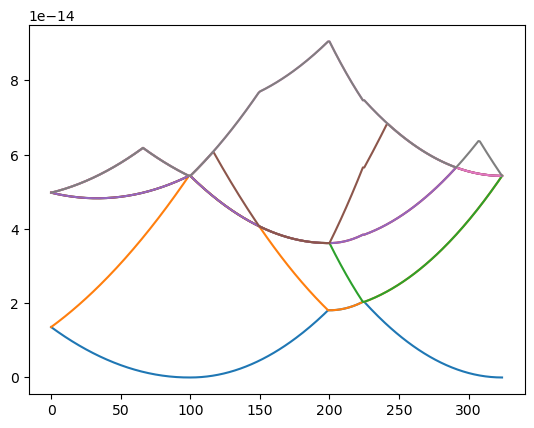

In [22]:
for i in bands1[:8]:
    plt.plot(i)


In [96]:
bands_10_10 = band_structure(H,K,L,0.0365*1e-10,14,1e-10,RECIPROCAL_BASIS,[lambd,delta,x_uk,sigma])

Potential matrix calculation done in 0.10 seconds
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
0
Processed k-point 1/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
1
Processed k-point 2/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.25 seconds
2
Processed k-point 3/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.18 seconds
3
Processed k-point 4/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.21 seconds
4
Processed k-point 5/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
5
Processed k-point 6/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.18 seconds
6
Processed k-point 7/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.19 seconds
7
Processed k-point 8/100
Hamiltonian calculation done i

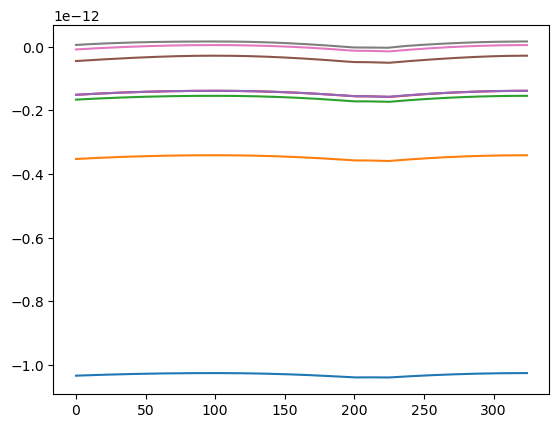

In [98]:
for i in bands_10_10[:8]:
    plt.plot(i)

In [99]:
bands_10_15 = band_structure(H,K,L,0.0365*1e-10,14,1e-15,RECIPROCAL_BASIS,[lambd,delta,x_uk,sigma])

Potential matrix calculation done in 0.10 seconds
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
0
Processed k-point 1/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
1
Processed k-point 2/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.18 seconds
2
Processed k-point 3/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
3
Processed k-point 4/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
4
Processed k-point 5/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.18 seconds
5
Processed k-point 6/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
6
Processed k-point 7/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.16 seconds
7
Processed k-point 8/100
Hamiltonian calculation done i

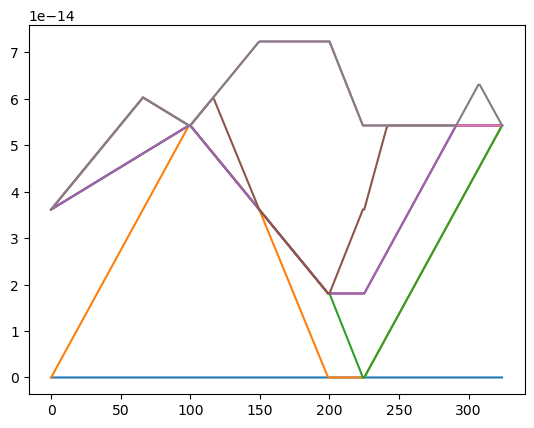

In [101]:
for i in bands_10_15[:8]:
    plt.plot(i)

In [102]:
bands_10_20 = band_structure(H,K,L,0.0365*1e-10,14,1e-20,RECIPROCAL_BASIS,[lambd,delta,x_uk,sigma])

Potential matrix calculation done in 0.11 seconds
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.16 seconds
0
Processed k-point 1/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.16 seconds
1
Processed k-point 2/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
2
Processed k-point 3/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.16 seconds
3
Processed k-point 4/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.18 seconds
4
Processed k-point 5/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.18 seconds
5
Processed k-point 6/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
6
Processed k-point 7/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.19 seconds
7
Processed k-point 8/100
Hamiltonian calculation done i

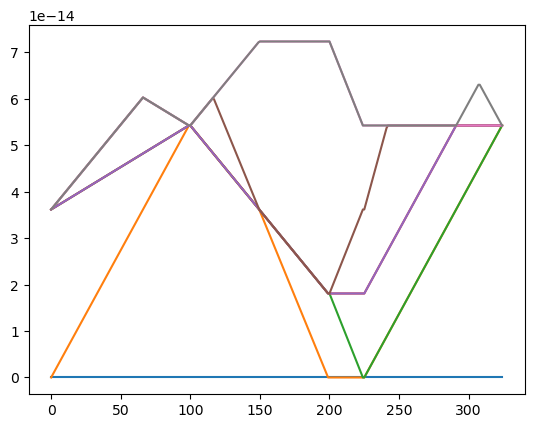

In [104]:
for i in bands_10_20[:8]:
    plt.plot(i)

In [107]:
bands_10_11 = band_structure(H,K,L,0.0365*1e-10,14,1e-11,RECIPROCAL_BASIS,[lambd,delta,x_uk,sigma])

Potential matrix calculation done in 0.11 seconds
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.19 seconds
0
Processed k-point 1/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
1
Processed k-point 2/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
2
Processed k-point 3/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.18 seconds
3
Processed k-point 4/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.20 seconds
4
Processed k-point 5/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.18 seconds
5
Processed k-point 6/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.18 seconds
6
Processed k-point 7/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.18 seconds
7
Processed k-point 8/100
Hamiltonian calculation done i

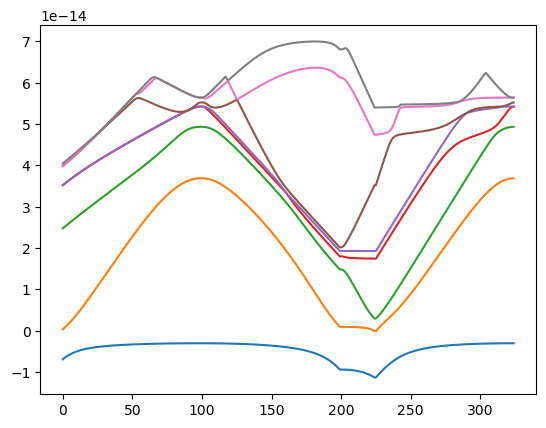

In [108]:
for i in bands_10_11[:8]:
    plt.plot(i)

In [112]:
bands_0 = band_structure(H,K,L,1e-10,1,0,RECIPROCAL_BASIS,[lambd,delta,x_uk,sigma])

Potential matrix calculation done in 0.21 seconds
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.20 seconds
0
Processed k-point 1/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
1
Processed k-point 2/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.15 seconds
2
Processed k-point 3/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.15 seconds
3
Processed k-point 4/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
4
Processed k-point 5/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.16 seconds
5
Processed k-point 6/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.16 seconds
6
Processed k-point 7/100
Hamiltonian calculation done in 0.01 seconds
Eigenvalue calculation done in 0.17 seconds
7
Processed k-point 8/100
Hamiltonian calculation done i

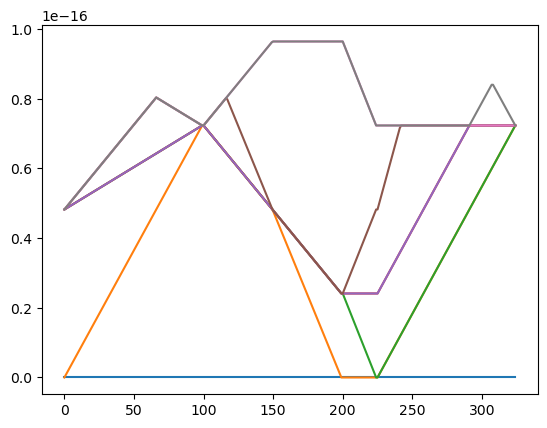

In [114]:
for i in bands_0[:8]:
    plt.plot(i)

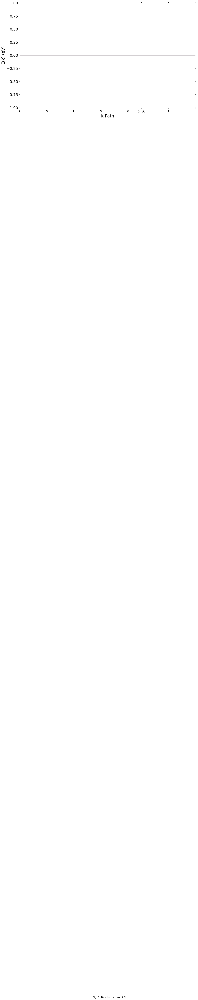

In [24]:
from matplotlib import pyplot as plt

%matplotlib inline
bands = bands1[:8]
# offset the bands so that the top of the valence bands is at zero
bands -= max(bands[3])

plt.figure(figsize=(15, 9))

ax = plt.subplot(111)

# remove plot borders
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)

# limit plot area to data
plt.xlim(0, len(bands))
plt.ylim(min(bands[0]) - 1, max(bands[7]) + 1)

# custom tick names for k-points
xticks = n * np.array([0, 0.5, 1, 1.5, 2, 2.25, 2.75, 3.25])
plt.xticks(xticks, ('$L$', '$\Lambda$', '$\Gamma$', '$\Delta$', '$X$', '$U,K$', '$\Sigma$', '$\Gamma$'), fontsize=18)
plt.yticks(fontsize=18)

# horizontal guide lines every 2.5 eV
for y in np.arange(-25, 25, 2.5):
    plt.axhline(y, ls='--', lw=0.3, color='black', alpha=0.3)

# hide ticks, unnecessary with gridlines
plt.tick_params(axis='both', which='both',
                top='off', bottom='off', left='off', right='off',
                labelbottom='on', labelleft='on', pad=5)

plt.xlabel('k-Path', fontsize=20)
plt.ylabel('E(k) (eV)', fontsize=20)

plt.text(135, -18, 'Fig. 1. Band structure of Si.', fontsize=12)

# tableau 10 in fractional (r, g, b)
colors = 1 / 255 * np.array([
    [31, 119, 180],
    [255, 127, 14],
    [44, 160, 44],
    [214, 39, 40],
    [148, 103, 189],
    [140, 86, 75],
    [227, 119, 194],
    [127, 127, 127],
    [188, 189, 34],
    [23, 190, 207]
])

for band, color in zip(bands, colors):
    plt.plot(band, lw=2.0, color=color)

plt.show()

In [ ]:

M = potential_matrix(H,K,L,potential_coefficient(5.43,144,1))

Haml,factor = halmitonian(M,np.array([lambd[0][0],lambd[1][0],lambd[2][0]]),H,K,L,reciprocal_basis=RECIPROCAL_BASIS,a=5.43)
print(Haml)
eigen_value,eigen_vector = linalg.eig(Haml)
print(np.sort(eigen_value))

In [ ]:
constants.electron_mass*constants.elementary_charge**2/(2*constants.pi**3*constants.epsilon_0*constants.hbar**2)


In [ ]:
potential_coefficient(5.43,144,1)

In [ ]:
for i in sigma:
    print(sigma)

In [42]:
14*constants.elementary_charge**2/(1e-10**2*constants.pi*constants.epsilon_0)/constants.electron_volt

8063801467918.374

In [24]:
constants.hbar**2*(2*constants.pi)**2/(2*1e-10**2*constants.electron_mass)

2.4098669608950283e-17